In [1]:
import os
import pandas as pd
import json
import matplotlib.pyplot as plt
import seaborn as sns
import networkx as nx
import numpy as np
import scipy

# 1. Load AFDB90 metadata and the community labels for each UniRef50 cluster

The AFB90 metadata was generated with the `1. Analyse UniRef50 and AFDB darkness` notebook, and is saved in `data_generated/AFDB90v4_data.csv`.

The community labels, on the other hand, were generated in multiple steps and are available in `data_generated/node_class.json`. The steps to generate this file are:

1. Run `scripts/sbatch_mmseqs_AFDB90_all-against-all.sh`. This will generate the `data_generated/AFDB90v4_all-gainst-all.m8` file, which is basically the distance matrix between all sequences in `data_generated/AFDB90_v4.fasta`
2. Run `scripts/sbatch_connect_component_collection.sh`. This will read `data_generated/AFDB90_v4.fasta` and `data_generated/AFDB90v4_all-gainst-all.m8` and collect connected components, saving the `data_generated/full_graph.gml` file and the `data_generated/node_class.json` file

In [2]:
AFDB90 = pd.read_csv('data_generated/AFDB90v4_data.csv', index_col=0)
AFDB90

,AF2_REP_best,AF2_REP_best_len,AF2_REP_worst,AF2_REP_worst_len,AF2_longest_best70,AF2_longest_best70_len,AF2_longest_best70_pLDDT,FULL_noDUF,REP,SP,...,max_pLDDT,median_Evidence,median_pLDDT,min_pLDDT,nACCs,nAF2,nUniRef100,nUniRef90,darkness_bins,Has_duf
UniRef50_A0A009E0R3,L9MAQ8,132.0,D3V7B3,106.0,L9MAQ8,132.0,90.250530,48.03,A0A009E0R3,0,...,90.250530,4.0,86.845354,71.984623,4,3,4,4,"(45.0, 50.0]",NaN
UniRef50_A0A009E3M2,A0A009E3M2,305.0,A0A3A8FAL8,363.0,A0A3A8FAL8,363.0,91.239890,83.75,A0A3A8FAL8,0,...,92.203279,4.0,91.721584,91.239890,3,2,3,2,"(80.0, 85.0]",NaN
UniRef50_A0A009EAW0,B1A003,226.0,A0A833PC88,236.0,A0A009EAW0,255.0,97.158902,99.57,B1A004,0,...,98.178363,4.0,97.250663,95.832288,8,6,6,3,"(95.0, 100.0]",NaN
UniRef50_A0A009EJF3,A0A009EJF3,109.0,NaN,NaN,A0A009EJF3,109.0,95.290183,98.17,A0A009EJF3,0,...,95.290183,3.0,95.290183,95.290183,2,1,2,1,"(95.0, 100.0]",NaN
UniRef50_A0A009EPC5,A0A009EPC5,118.0,NaN,NaN,A0A009EPC5,118.0,91.145678,0.00,NaN,0,...,91.145678,4.0,91.145678,91.145678,3,1,3,2,"(-0.001, 5.0]",0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
UniRef50_Z9JYB6,Z9JYB6,349.0,NaN,NaN,Z9JYB6,349.0,96.764670,99.43,Z9JYB6,0,...,96.764670,4.0,96.764670,96.764670,1,1,1,1,"(95.0, 100.0]",NaN
UniRef50_Z9JYJ6,H0R019,332.0,A0A1I0ZVZ7,331.0,Z9JYJ6,391.0,95.762737,99.10,A0A7K3DKT6,0,...,97.183343,3.0,95.762737,79.008066,10,5,9,7,"(95.0, 100.0]",NaN
UniRef50_Z9JYL0,A0A1X6WVI3,275.0,Z9JYL0,302.0,A0A2U2RJ04,303.0,93.134389,99.34,Z9JYL0,0,...,95.427382,3.0,93.134389,93.083079,8,3,7,4,"(95.0, 100.0]",NaN
UniRef50_Z9JYP3,C0W3Y4,82.0,W1VI89,53.0,A0A4P9JAL3,492.0,90.347215,95.84,C0W3Y3,0,...,95.799146,4.0,93.827309,88.457547,366,197,351,136,"(95.0, 100.0]",NaN


In [3]:
graph_data = 'data_generated/node_class.json'
graph_data = json.load(open(graph_data, 'r'))
graph_data = pd.DataFrame(graph_data)

graph_data['unirefID'] = 'UniRef50_' + graph_data['node']
graph_data = graph_data.sort_values(by='unirefID')
graph_data = graph_data.set_index('unirefID')
graph_data = graph_data[['subgraphID','communityID']]
graph_data

,subgraphID,communityID
unirefID,,
UniRef50_A0A009E0R3,0,0[63723]
UniRef50_A0A009E3M2,0,0[24001]
UniRef50_A0A009EAW0,0,0[263862]
UniRef50_A0A009EJF3,0,0[14005]
UniRef50_A0A009EPC5,0,0[21031]
...,...,...
UniRef50_Z9JY68,0,0[122217]
UniRef50_Z9JYB6,0,0[174901]
UniRef50_Z9JYJ6,0,0[282469]


In [4]:
AFDB90 = pd.concat([AFDB90, graph_data], axis=1)
AFDB90.to_csv('data_generated/AFDB90v4_all_data.csv')

# 2. Count number of edges

In [5]:
graph = 'data_generated/full_graph.gml'
count = 0
found_edge = False
with open(graph, 'r') as g:
    for line in g:
        if 'edge' in line:
            count +=1
print('No. edges:', count)

No. edges: 10339158


# 3. Analyse only those UniRef50 clusters in connected components

In [6]:
AFDB90_CC = AFDB90.loc[AFDB90.subgraphID.notnull()]
AFDB90_CC.index.name = 'unirefID'
AFDB90_CC.to_csv('data_generated/AFDB90v4_cc_data.csv')

In [7]:
dark_in_graph = len(AFDB90_CC.loc[AFDB90_CC.FULL_noDUF <= 5])
all_dark      = len(AFDB90.loc[AFDB90.FULL_noDUF <= 5])

print('Singleton darks:', all_dark-dark_in_graph, '%of dark in graph:', dark_in_graph*100/all_dark)

Singleton darks: 527584 %of dark in graph: 43.11480677208789


## 3.1 Make a summary table of all connected components and analyse their darkness distribution

In [8]:
# subgraphs_summary = {'Subgraph': [], 'Avg_darkness': [], 'SD_darkness': [], 'N_members': [], 'TM': [], 'SP': [], 
#                      'Median_length': [], 'MAD_length': [], 'Median_darkness': [], 'MAD_darkness': [], 'N_communities': []}

# for subgraph_class in range(max(AFDB90_CC.subgraphID.astype('int'))):
#     subgr_members = AFDB90_CC.loc[AFDB90_CC.subgraphID.astype('int') == subgraph_class]
    
#     subgraphs_summary['Subgraph'].append(subgraph_class)
    
#     subgraphs_summary['Avg_darkness'].append(np.mean(subgr_members.FULL_noDUF.astype(float)))
#     subgraphs_summary['SD_darkness'].append(np.std(subgr_members.FULL_noDUF.astype(float)))
    
#     subgraphs_summary['Median_darkness'].append(np.median(subgr_members.FULL_noDUF.astype(float)))
#     subgraphs_summary['MAD_darkness'].append(scipy.stats.median_abs_deviation(subgr_members.FULL_noDUF.astype(float)))
    
#     subgraphs_summary['N_members'].append(len(subgr_members))
#     subgraphs_summary['N_communities'].append(len(set(subgr_members.communityID)))
    
#     subgraphs_summary['TM'].append((len(subgr_members)-list(subgr_members.TM).count(0))*100/len(subgr_members))
#     subgraphs_summary['SP'].append((len(subgr_members)-list(subgr_members.SP).count(0))*100/len(subgr_members))
    
#     subgraphs_summary['Median_length'].append(np.median(subgr_members.AF2_longest_best70_len.astype(float)))
#     subgraphs_summary['MAD_length'].append(scipy.stats.median_abs_deviation(subgr_members.AF2_longest_best70_len.astype(float)))
       
# subgraphs_summary = pd.DataFrame(subgraphs_summary)
# subgraphs_summary = subgraphs_summary.set_index('Subgraph')
# subgraphs_summary = subgraphs_summary.sort_values(by='N_members', ascending=False)

# subgraphs_summary.to_csv('data_generated/AFDB90v4_subgraphs_summary.csv')

In [9]:
subgraphs_summary = pd.read_csv('data_generated/AFDB90v4_subgraphs_summary.csv')
subgraphs_summary = subgraphs_summary.set_index('Subgraph')
subgraphs_summary

,Avg_darkness,SD_darkness,N_members,TM,SP,Median_length,MAD_length,Median_darkness,MAD_darkness,N_communities
Subgraph,,,,,,,,,,
0,88.965221,22.034931,3036238,0.272574,0.272574,233.0,98.0,97.440,2.050,358579
1,88.189645,28.734713,1946,0.000000,0.000000,278.0,29.0,98.230,0.830,298
2,91.191058,11.996458,1871,2.030999,2.030999,493.0,49.0,95.000,2.020,301
3,83.702536,26.760281,1672,0.000000,0.000000,180.5,41.5,94.035,3.835,143
4,80.757456,26.934344,1490,0.000000,0.000000,139.0,7.0,94.160,3.705,213
...,...,...,...,...,...,...,...,...,...,...
147996,98.270000,1.390000,2,0.000000,0.000000,223.5,94.5,98.270,1.390,1
147995,0.000000,0.000000,2,0.000000,0.000000,184.0,0.0,0.000,0.000,1
147994,0.000000,0.000000,2,0.000000,0.000000,326.0,76.0,0.000,0.000,1


50000 n =	 3036238 n_CC =	 1
1000 n =	 22874 n_CC =	 17
500 n =	 41046 n_CC =	 58
300 n =	 41954 n_CC =	 112
100 n =	 125434 n_CC =	 779
50 n =	 91313 n_CC =	 1342
10 n =	 270403 n_CC =	 14517
5 n =	 167413 n_CC =	 26522
2 n =	 473727 n_CC =	 199528


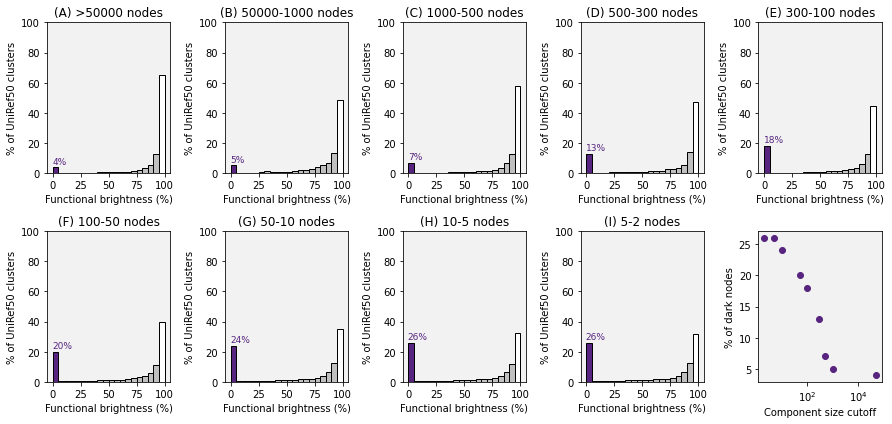

In [10]:
levels = [50000, 1000, 500, 300, 100, 50, 10, 5, 2]
panel = ['A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K']

dark_percent = []

ncols  = 5
nlines = int((len(levels)+1)/ncols)

fig, ax = plt.subplots(nlines, ncols, figsize=(2.5*ncols, 3*nlines))

curr_col  = 0
curr_line = 0
    
for j, mode in enumerate(levels):
        
    tmp_summary = subgraphs_summary.loc[subgraphs_summary.N_members >= mode]
    title = '({}) >{} nodes'.format(panel[j], mode)
    if j > 0:
        tmp_summary = tmp_summary.loc[tmp_summary.N_members < levels[j-1]]
        title = '({}) {}-{} nodes'.format(panel[j], levels[j-1], mode)
        
    tmp = AFDB90_CC.loc[AFDB90_CC.subgraphID.isin(tmp_summary.index)]
                
    h,_ = np.histogram(tmp.FULL_noDUF.astype(float), bins=[i for i in range(0, 105, 5)])
    h = h*100/sum(h)

    colors = ['#57257F']
    for i in range(len(h)-2):
        colors.append('silver')
    colors.append('white')
    
    x = list(range(len(h)))
    y = list(h)

    ax[curr_line][curr_col].bar(x,y,1, align='edge', color=colors, edgecolor='k')
    ax[curr_line][curr_col].set_facecolor('#F2F2F2')
    ax[curr_line][curr_col].set_xticks(range(0,21,5))
    ax[curr_line][curr_col].set_xticklabels(range(0,101,25))
    ax[curr_line][curr_col].set_ylabel('% of UniRef50 clusters')
    ax[curr_line][curr_col].set_xlabel('Functional brightness (%)')
    
    ax[curr_line][curr_col].title.set_text(title)

    ax[curr_line][curr_col].set_ylim(0,100)
    
    percentage_dark = round(h[0])
    ax[curr_line][curr_col].text(-0.1, percentage_dark+1, '{}%'.format(percentage_dark),
                                 verticalalignment='bottom', horizontalalignment='left',
                                 color='#57257F', fontsize=9)
    
    dark_percent.append(percentage_dark)
    
    print(mode, 'n =\t', len(tmp), 'n_CC =\t', len(tmp_summary))
    
    curr_col  +=1
    if curr_col == ncols:
        curr_col   = 0
        curr_line += 1

ax[curr_line][curr_col].scatter(levels, dark_percent, color=colors[0])
ax[curr_line][curr_col].set_facecolor('#F2F2F2')
ax[curr_line][curr_col].set_ylabel('% of dark nodes')
ax[curr_line][curr_col].set_xlabel('Component size cutoff')
ax[curr_line][curr_col].set_xscale('log')

plt.tight_layout()
plt.savefig('plots/AFDB90v4_histogram_dark_content.pdf')
plt.savefig('plots/AFDB90v4_histogram_dark_content.png', dpi=2000)

n = 242876
n = 242876
n = 242876


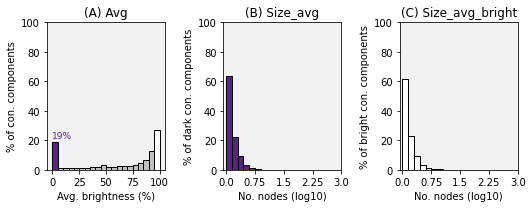

In [11]:
modes = ['Avg', 'Size_avg', 'Size_avg_bright']
panels = ['A', 'B', 'C']

fig, ax = plt.subplots(1, len(modes), figsize=(2.5*len(modes), 3))

for j, mode in enumerate(modes):
    
    if mode == 'Median':
        h,_ = np.histogram(subgraphs_summary.Median_darkness, bins=[i for i in range(0, 105, 5)])
    elif mode == 'Avg':
        h,_ = np.histogram(subgraphs_summary.Avg_darkness, bins=[i for i in range(0, 105, 5)])
    
    elif 'Size' in mode:
        if 'median' in mode:
            dark_galaxies = subgraphs_summary.loc[subgraphs_summary.Median_darkness <= 5]
        elif 'bright' not in mode:
            dark_galaxies = subgraphs_summary.loc[subgraphs_summary.Avg_darkness <= 5]
        else:
            dark_galaxies = subgraphs_summary.loc[subgraphs_summary.Avg_darkness >= 95]
            
        h,_ = np.histogram(np.log10(dark_galaxies.N_members), bins=[i for i in np.linspace(0, 3, 10)])

    h = h*100/sum(h)
    
    colors = ['#57257F']
    for i in range(len(h)-2):
        colors.append('silver')
    colors.append('white')
    
    if'Size' in mode:
        if 'bright' in mode:
            colors = ['white' for i in range(len(h))]
        else:
            colors = ['#57257F' for i in range(len(h))]

    x = list(range(len(h)))
    y = list(h)

    ax[j].bar(x,y,1, align='edge', color=colors, edgecolor='k')
    ax[j].set_facecolor('#F2F2F2')
    
    if'Size' in mode:
        if 'bright' in mode:
            ax[j].set_ylabel('% of bright con. components')
        else:
            ax[j].set_ylabel('% of dark con. components')
        ax[j].set_xlabel('No. nodes (log10)')
        ax[j].set_xticks(range(0,21,5))
        ax[j].set_xticklabels(np.linspace(0, 3, 5))
    else:
        ax[j].set_xticks(range(0,21,5))
        ax[j].set_xticklabels(range(0,101,25))
        ax[j].set_ylabel('% of con. components')
        ax[j].set_xlabel('{}. brightness (%)'.format(mode))
        
        percentage_dark = round(h[0])
        ax[j].text(-0.1, percentage_dark+1, '{}%'.format(percentage_dark),
                   verticalalignment='bottom', horizontalalignment='left',
                   color='#57257F', fontsize=9)

    ax[j].title.set_text('({}) {}'.format(panel[j], mode))

    ax[j].set_ylim(0,100)
    
    print('n =', len(subgraphs_summary))
    
plt.tight_layout()
plt.savefig('plots/AFDB90v4_component_darkness_histogram.pdf')
plt.savefig('plots/AFDB90v4_component_darkness_histogram.png', dpi=2000)

## 3.2. Select only those dark clusters (avg. darkness <= 5%) and analyse those

In [12]:
dark_galaxies = subgraphs_summary.loc[subgraphs_summary.Avg_darkness <= 5].sort_values(by='N_members', ascending=False)
dark_galaxies

,Avg_darkness,SD_darkness,N_members,TM,SP,Median_length,MAD_length,Median_darkness,MAD_darkness,N_communities
Subgraph,,,,,,,,,,
27,2.384557,12.615117,836,1.196172,1.196172,665.0,169.0,0.00,0.00,146
133,0.549566,4.277854,369,0.000000,0.000000,144.0,20.0,0.00,0.00,56
147,2.884870,13.924139,345,0.000000,0.000000,113.0,8.0,0.00,0.00,31
156,1.032054,3.496461,331,0.000000,0.000000,295.0,23.0,0.00,0.00,22
159,1.114251,4.596725,327,0.000000,0.000000,120.0,9.0,0.00,0.00,60
...,...,...,...,...,...,...,...,...,...,...
234487,0.000000,0.000000,2,0.000000,0.000000,151.5,0.5,0.00,0.00,1
234497,0.000000,0.000000,2,0.000000,0.000000,112.0,1.0,0.00,0.00,1
234493,0.000000,0.000000,2,0.000000,0.000000,262.5,0.5,0.00,0.00,1


In [ ]:
### 3.2.1. Get a structural representative per dark galaxy
# import networkx as nx

# central_representatives = []
# longest_representatives = []
# median_representatives  = []

# for i, node_class in enumerate(dark_galaxies.index):
    
#     graph = 'data_generated/subgraphs/subgraph_{:06d}.gml'.format(node_class)
#     G = nx.read_gml(graph)
#     centralities = nx.degree_centrality(G)
#     central_representative, centrality = sorted([(k, centralities[k]) for k in G.nodes], key=lambda x: x[1], reverse=True)[0]
    
#     tmp = AFDB90_CC.loc[AFDB90_CC.subgraphID == node_class]
    
#     central_representative = tmp.loc['UniRef50_{}'.format(central_representative)].AF2_longest_best70
    
#     median = dark_galaxies.loc[node_class]['Median_length']
#     tmp['dist_to_median'] = abs(tmp.AF2_REP_best_len - median)
#     median_representative = tmp.sort_values(by='dist_to_median', ascending=True).AF2_longest_best70[0]
    
#     longest_representative = tmp.sort_values(by='AF2_REP_best_len', ascending=False).AF2_longest_best70[0]
    
#     if i%1000 == 0:
#         print(i, len(dark_galaxies), 'CURR NODE CLASS:', node_class)
#         print(central_representative, median_representative, longest_representative)
    
#     central_representatives.append(central_representative)
#     median_representatives.append(median_representative)
#     longest_representatives.append(longest_representative)

# dark_galaxies['Central_representative'] = central_representatives
# dark_galaxies['Longest_representative'] = longest_representatives
# dark_galaxies['Median_representative'] = median_representatives

# dark_galaxies.to_csv('data_generated/AFDB90v4_dark_galaxies_summary.csv')

In [14]:
dark_galaxies = pd.read_csv('data_generated/AFDB90v4_dark_galaxies_summary.csv', index_col=0)
dark_galaxies

,Avg_darkness,SD_darkness,N_members,TM,SP,Median_length,MAD_length,Median_darkness,MAD_darkness,N_communities,Central_representative,Longest_representative,Median_representative
Subgraph,,,,,,,,,,,,,
27,2.384557,12.615117,836,1.196172,1.196172,665.0,169.0,0.00,0.00,146,A0A519QYA9,A0A3M1BQA7,A0A7X7MB17
133,0.549566,4.277854,369,0.000000,0.000000,144.0,20.0,0.00,0.00,56,A2BLU4,A0A2H6AC47,A0A7K3YDN3
147,2.884870,13.924139,345,0.000000,0.000000,113.0,8.0,0.00,0.00,31,A0A2P8DAJ8,A0A495MCZ6,A0A1V4Z6N0
156,1.032054,3.496461,331,0.000000,0.000000,295.0,23.0,0.00,0.00,22,A0A1Y4T2K8,E4Q739,R6CWS2
159,1.114251,4.596725,327,0.000000,0.000000,120.0,9.0,0.00,0.00,60,F2KQ93,A0A2N2PUA8,A0A6N7ITV5
...,...,...,...,...,...,...,...,...,...,...,...,...,...
234487,0.000000,0.000000,2,0.000000,0.000000,151.5,0.5,0.00,0.00,1,A0A842IXQ4,A0A7X1HP91,A0A842IXQ4
234497,0.000000,0.000000,2,0.000000,0.000000,112.0,1.0,0.00,0.00,1,A0A7J3D7Q5,A0A524I3Y4,A0A7J3D7Q5
234493,0.000000,0.000000,2,0.000000,0.000000,262.5,0.5,0.00,0.00,1,A0A842KMP2,A0A842KMP2,A0A842KMP2


In [15]:
true_dark_uniref50 = 'UniRef50_A0A0S6VSC9' # example member of the true dark galaxy (the toxin, component 159)
true_dark_galaxy   = AFDB90.loc[true_dark_uniref50].subgraphID

print('Connected component of the true dark galaxy:', true_dark_galaxy)

AFDB90_CC.loc[AFDB90_CC.subgraphID == true_dark_galaxy].sort_values(by='FULL_noDUF', ascending=False)

Connected component of the true dark galaxy: 159.0


,AF2_REP_best,AF2_REP_best_len,AF2_REP_worst,AF2_REP_worst_len,AF2_longest_best70,AF2_longest_best70_len,AF2_longest_best70_pLDDT,FULL_noDUF,REP,SP,...,median_pLDDT,min_pLDDT,nACCs,nAF2,nUniRef100,nUniRef90,darkness_bins,Has_duf,subgraphID,communityID
unirefID,,,,,,,,,,,,,,,,,,,,,
UniRef50_A0A524APL3,A0A524APL3,72.0,NaN,NaN,A0A524APL3,72.0,93.008056,34.72,A0A524APL3,0,...,93.008056,93.008056,1,1,1,1,"(30.0, 35.0]",NaN,159.0,159[20]
UniRef50_A0A3M1A5L5,A0A3M1A5L5,82.0,NaN,NaN,A0A3M1A5L5,82.0,93.461341,23.17,A0A3M1A5L5,0,...,93.461341,93.461341,1,1,1,1,"(20.0, 25.0]",NaN,159.0,159[24]
UniRef50_A0A1F8QW58,A0A1F8QW58,133.0,NaN,NaN,A0A1F8QW58,133.0,95.351128,21.05,A0A1F8QW58,0,...,95.351128,95.351128,1,1,1,1,"(20.0, 25.0]",NaN,159.0,159[36]
UniRef50_N6YUN3,A0A259EYX3,121.0,A0A4S4ARD3,116.0,A0A0C3N1T3,124.0,94.493468,20.97,A0A0C3N1T3,0,...,93.995278,83.866121,43,36,37,28,"(20.0, 25.0]",NaN,159.0,159[39]
UniRef50_A0A2T0SYA6,A0A515A520,116.0,A0A2K8Z4H6,121.0,A0A286GCB7,121.0,93.414545,19.66,A0A2T0SYA6,0,...,94.667672,92.932397,10,7,10,10,"(15.0, 20.0]",NaN,159.0,159[56]
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
UniRef50_A0A2N1XDU0,E6QX76,116.0,A0A2N1XDU0,118.0,A0A2N1XDU0,118.0,95.231271,0.00,NaN,0,...,95.702575,95.231271,2,2,2,2,"(-0.001, 5.0]",0.0,159.0,159[39]
UniRef50_A0A2M8GHX1,A0A2G9XIS1,123.0,A0A2M8GHX1,123.0,A0A2G9XIS1,123.0,93.151301,0.00,NaN,0,...,93.044187,92.937073,2,2,1,1,"(-0.001, 5.0]",0.0,159.0,159[24]
UniRef50_A0A2M7UZM5,A0A2M7Z4P5,119.0,A0A2M7UZM5,119.0,A0A2H0TJA4,119.0,95.451681,0.00,NaN,0,...,95.451681,95.400756,3,3,1,1,"(-0.001, 5.0]",0.0,159.0,159[11]


# 4. Get summary of all communities in all components and plot the graph

As we have more than 6 million nodes, >4 million making connected components, this is too large to visualise. So we summarise the graph into components of communities. To do that, 

1. Run `scripts/sbatch_make_communities_graph.sh`, which will generate the `communities_edge_list.csv` file. (A reprocessed version of this file, `data_generated/communities_edge_list_no_duplicates.csv` where A-B and B-A edges are merged into A-B is provided)
2. Load this list of edges into Cosmograph app (https://cosmograph.app/run/) and after happy with the layout, download the coordinates (saved in `data_generated/communities_edge_list-coordinates.csv`)
3. Run `python3 scripts/get_uniprot_taxonomy.py` to map taxonomy to each component, which generates the `data_generated/uniprot_community_taxonomy_map.csv` file
4. Run `scripts/sbatch_community_summary.sh`, which generates the `data_generated/communities_summary.csv` file. This includes all metadata for each node in the interactive version of the graph, including structure representatives

In [16]:
communities_summary = pd.read_csv('data_generated/communities_summary.csv')
communities_summary = communities_summary.set_index("Community")
communities_summary

,Subgraph,Avg_darkness,SD_darkness,Avg_outlier_score,SD_outlier_score,N_members,TM,SP,Median_length,MAD_length,Median_darkness,MAD_darkness,Median_representative,Longest_representative,Median_rep_title,Mode_superkingdom,Freq_superkingdom
Community,,,,,,,,,,,,,,,,,
0[841],0,95.339493,8.118564,0.094639,0.033115,3528,0.0,0.0,296.0,8.0,97.260,1.370,A0A0R2CST8,A0A536Z7Y0,HTH lysR-type domain-containing protein,Bacteria,99.973267
0[839],0,96.289401,6.584533,0.071551,0.024975,3471,0.0,0.0,249.0,17.0,98.170,1.350,X1X8T8,A0A1I6S7U2,GP-PDE domain-containing protein,Bacteria,99.149286
0[652],0,77.993089,12.295137,0.100184,0.022763,3185,0.0,0.0,327.0,14.0,76.660,6.910,A0A329USX1,A0A0U3DP79,Glycosyltransferase,Bacteria,99.478261
0[0],0,97.705826,2.522684,0.051707,0.010156,2959,0.0,0.0,106.0,27.0,98.630,0.520,A0A7K9TJ19,A0A6P6NWT3,ZN782 protein,Eukaryota,99.803647
0[1633],0,97.503714,5.898314,0.085754,0.029148,2337,0.0,0.0,251.0,28.0,98.830,0.750,A0A7C4USN7,K9PW16,ParA family protein,Bacteria,99.010466
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
0[273506],0,92.010000,6.040000,0.112500,0.000500,2,0.0,0.0,241.5,36.5,92.010,6.040,A0A662GLL9,A0A7J4UHL0,Methyltransferase,Archaea,100.000000
153946[0],153946,88.405000,0.645000,0.117500,0.002500,2,0.0,0.0,340.0,1.0,88.405,0.645,A0A6A6CXE6,A0A6A6CXE6,NmrA domain-containing protein,Eukaryota,100.000000
0[315654],0,0.000000,0.000000,0.105000,0.001000,2,0.0,0.0,274.0,102.0,0.000,0.000,A0A1V4M9A9,A0A1V4M9A9,GTP cyclohydrolase 1 type 2 homolog,Bacteria,100.000000


## 4.1. Plot the large graph with datashader

In [17]:
import datashader as ds
import datashader.transfer_functions as tf
from datashader.bundling import connect_edges
from datashader.utils import export_image

import matplotlib

In [18]:
def make_color_key(cmap, cat, cats=None):
    
    if cats is None:
        cats = sorted(list(set(cat)))
    else:
        cats = sorted(list(set(cats)))
    
    cmap = matplotlib.cm.get_cmap(cmap)
    norm = matplotlib.colors.Normalize(vmin=min(cats), vmax=max(cats))
    
    color_key = {cats[i]: tuple([int(255*j) for j in cmap(norm(i))[:3]]) for i in range(len(cats))}
        
    return color_key
    
def nodesplot(nodes, name=None, canvas=None, cat=None, cmap='Purples_r', res=5, cats=None):
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    aggregator=None if cat is None else ds.count_cat(cat)
    agg=canvas.points(nodes,'x','y',aggregator)
    
    color_key = make_color_key(cmap, nodes[cat], cats=cats)
    
    return tf.spread(tf.shade(agg, color_key=color_key), px=res, name=name)

def edgesplot(edges, name=None, canvas=None):
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    return tf.shade(canvas.line(edges, 'x','y', agg=ds.count()), name=name, cmap=['lightgrey'])
    
def graphplot(nodes, edges, name="", canvas=None, cat=None, res=5, cmap='Purples_r', cats=None, pad = 0.001):
    
    if res == 1:
        cvsopts = dict(plot_height=res*300, plot_width=res*300)
        res = 3
    else:
        cvsopts = dict(plot_height=res*1000, plot_width=res*1000)

    if canvas is None:
        xr = nodes.x.min()-pad*nodes.x.min(), nodes.x.max()+pad*nodes.x.max()
        yr = nodes.y.min()-pad*nodes.y.min(), nodes.y.max()+pad*nodes.y.max()
        canvas = ds.Canvas(x_range=xr, y_range=yr, **cvsopts)
    
    np = nodesplot(nodes, name + " nodes", canvas, cat, res=res, cmap=cmap, cats=cats)
    ep = edgesplot(edges, name + " edges", canvas)
    return tf.stack(ep, np, how="over", name=name)

In [19]:
coordinates = 'data_generated/communities_edge_list-coordinates.csv'
coordinates = pd.read_csv(coordinates, sep=';')
coordinates = coordinates.set_index('id').sort_index().dropna()
coordinates['Avg_darkness'] = communities_summary.loc[communities_summary.index.isin(coordinates.index)].sort_index()['Avg_darkness']
coordinates['Component'] = communities_summary.loc[communities_summary.index.isin(coordinates.index)].sort_index()['Subgraph']
coordinates

,x,y,Avg_darkness,Component
id,,,,
0[0],4543.242676,4788.432617,97.705826,0
0[100000],3103.872070,5371.979980,99.155000,0
0[100001],3153.134033,4098.204590,94.748000,0
0[100002],4378.573730,2472.768799,77.385000,0
0[100003],3065.299805,4927.826660,95.176000,0
...,...,...,...,...
9[96],6562.376465,6530.248535,80.992500,9
9[97],6549.901367,6509.102051,89.352500,9
9[98],6548.206055,6507.639160,65.095000,9


In [20]:
edgesfile = 'data_generated/communities_edge_list_no_duplicates.csv'
edges = {'from': [], 'to': []}
with open(edgesfile, 'r') as outf:
    for line in outf:
        if 'source' not in line and 'innode' not in line:
            from_node, to_node = line.strip().split(',')
            
            edges['from'].append(from_node)
            edges['to'].append(to_node)

In [21]:
bins = [i for i in range(0, 100, 5)]

curr_nodes = coordinates[['x','y','Avg_darkness']]
curr_nodes['Avg_darkness'] = [np.digitize([darkness],bins)[0] for darkness in curr_nodes['Avg_darkness']]
curr_nodes['Avg_darkness'] = curr_nodes['Avg_darkness'].astype("category")

curr_edges = pd.DataFrame(edges)
curr_edges.columns = ['source', 'target']

/scicore/home/schwede/soares0000/projects/dark_protein_universe/venv/lib/python3.6/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/scicore/home/schwede/soares0000/projects/dark_protein_universe/venv/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


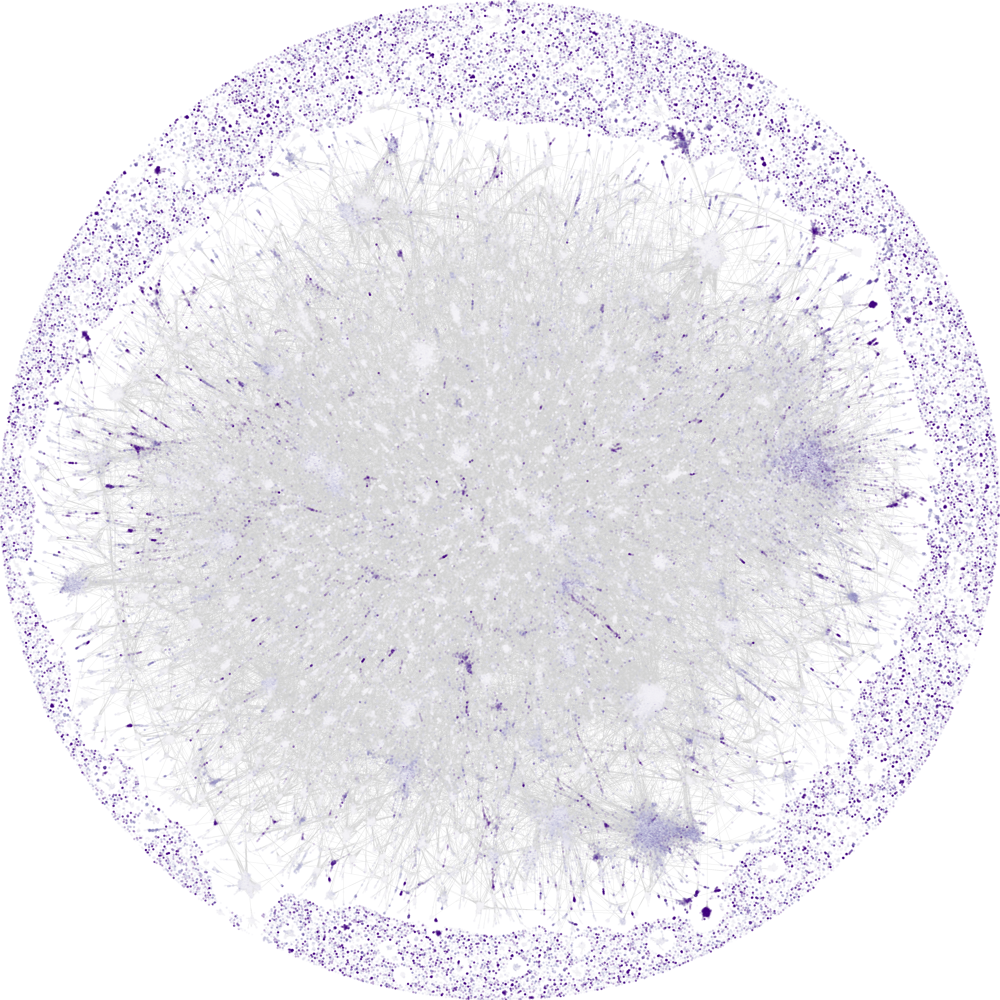

In [22]:
direct = connect_edges(curr_nodes, curr_edges)
g = graphplot(curr_nodes, direct, cat = 'Avg_darkness', pad=0.001)

filename = 'plots/community_cosmograph_layout_darkness'
ds.utils.export_image(g,filename=filename)

## 4.2. Plot graph of selected component

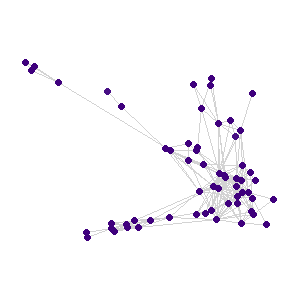

In [24]:
target_component = 159 # TumE
target_coordinates = coordinates.loc[coordinates.Component == target_component]

target_nodes = curr_nodes.loc[curr_nodes.index.isin(target_coordinates.index)]
target_edges = curr_edges.loc[(curr_edges.source.isin(target_coordinates.index)) & (curr_edges.target.isin(target_coordinates.index))]

direct = connect_edges(target_nodes, target_edges)
g = graphplot(target_nodes, direct, cat = 'Avg_darkness', cats = curr_nodes['Avg_darkness'], res = 1)

filename = 'plots/component{}_community_cosmograph_layout_darkness'.format(target_component)
ds.utils.export_image(g,filename=filename)

## 4.3. Add singletons to list of coordinates, which is displayed in the interactive version of the network

In [28]:
min_x, max_x = (coordinates.x.min(), coordinates.x.max())
print('min_x:', min_x, 'max_x:', max_x)

min_y, max_y = (coordinates.y.min(), coordinates.y.max())
print('min_y:', min_y, 'max_y:', max_y)

center = ((max_x-min_x)/2)+min_x, ((max_y-min_y)/2)+min_y
print('center:', center)

radius = round(max([(max_x-min_x)/2, (max_y-min_y)/2]))+1
print('radius:', radius)

min_x: 428.4693603515625 max_x: 7771.96142578125
min_y: 417.8332214355469 max_y: 7771.74951171875
center: (4100.215393066406, 4094.7913665771484)
radius: 3678


In [27]:
from math import sin, cos, radians, pi, sqrt

def meteorites(radius, center):
    angle = np.random.uniform(0, 2 * pi)  # in radians
    distance = sqrt(np.random.uniform(1.001*radius**2, 1.2*radius**2))
    return distance * cos(angle)+center[0], distance * sin(angle)+center[0]

In [35]:
nodes_wo_coords = set(list(communities_summary.index))-set(coordinates.index)

new_coords = {'id':[], 'x':[], 'y':[]}
for node in nodes_wo_coords:
    x, y = meteorites(radius, center)
    new_coords['id'].append(node)
    new_coords['x'].append(x)
    new_coords['y'].append(y)

new_coords = pd.DataFrame(new_coords)
new_coords = new_coords.set_index('id')

nodes_xyz = pd.concat([coordinates[['x','y']], new_coords], axis=0)

In [37]:
nodes_xyz.to_csv('data_generated/communities_edge_list-coordinates_with_singletons.csv')